<a href="https://colab.research.google.com/github/sahilfaizal01/Detectron2/blob/main/Detectron2_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train_img_path = '/content/drive/My Drive/Dataset/train'
val_img_path = '/content/drive/My Drive/Dataset/valid'
train_annotation_path = '/content/drive/My Drive/Dataset/train/train.coco.json'
val_annotation_path = '/content/drive/My Drive/Dataset/valid/test.coco.json'

# Install detectron2

In [ ]:
!python -m pip install pyyaml==5.1
# Detectron2 has not released pre-built binaries for the latest pytorch (https://github.com/facebookresearch/detectron2/issues/4053)
# so we install from source instead. This takes a few minutes.
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

# Install pre-built detectron2 that matches pytorch version, if released:
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
#!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/{CUDA_VERSION}/{TORCH_VERSION}/index.html

# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 34.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=53be0a6c07d7284dcef7cdb86796b832c070b7b07be5dfc21a3425495a064792
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-7one2b9s
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-7one2b9s
     |████████████████████████████████| 50 kB 7.3 MB/s 
     |████████████████████████████████| 79 kB

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0
torch:  1.11 ; cuda:  cu113
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

[06/06 19:24:34 d2.data.datasets.coco]: Loading /content/drive/My Drive/Dataset/train/train.coco.json takes 1.35 seconds.
WARNING [06/06 19:24:34 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/06 19:24:34 d2.data.datasets.coco]: Loaded 16 images in COCO format from /content/drive/My Drive/Dataset/train/train.coco.json


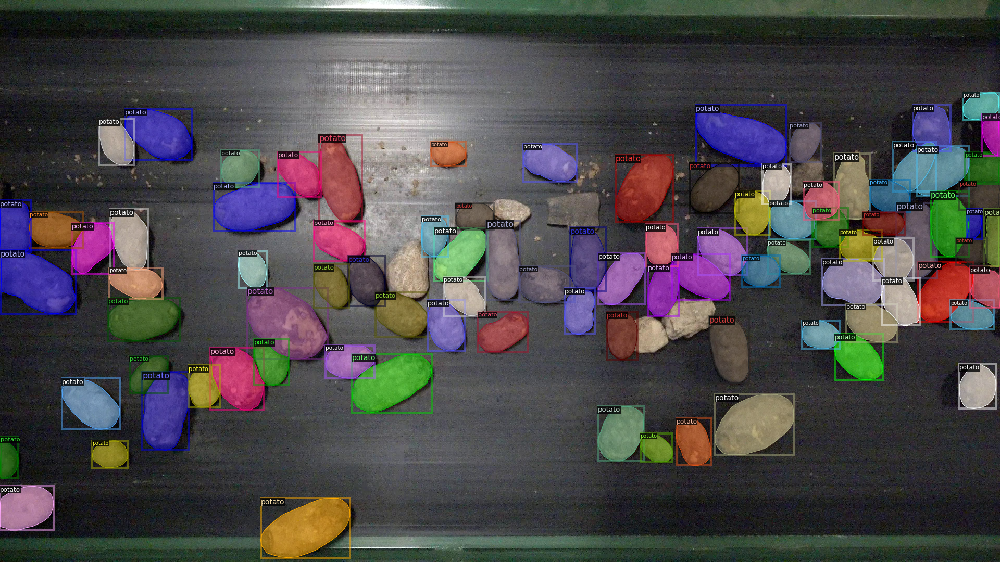

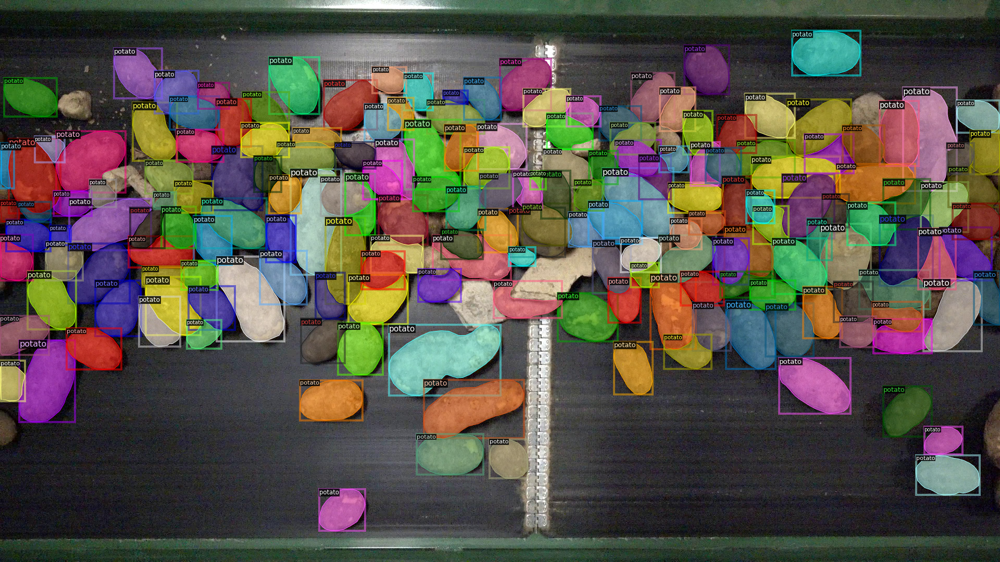

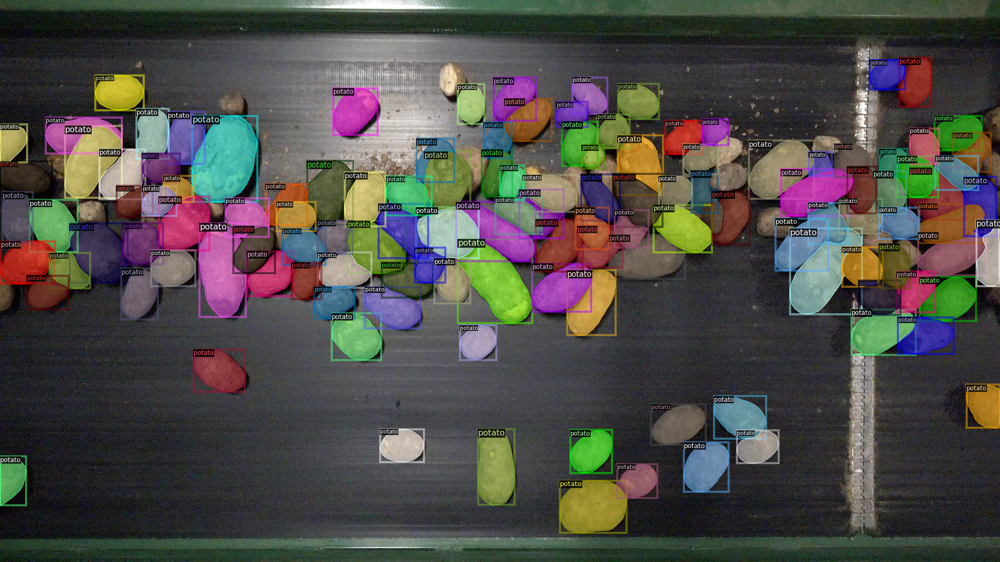

In [ ]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("data_train", {}, train_annotation_path, train_img_path)
register_coco_instances("data_val", {}, val_annotation_path, val_img_path)

#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("data_train")
dataset_dicts = DatasetCatalog.get("data_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
from detectron2.engine import DefaultTrainer
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml") # Let training initialize from model zoo

cfg.OUTPUT_DIR = "/content/drive/My Drive/Dataset/output_dir"
cfg.DATASETS.TRAIN = ("data_train",)
cfg.DATASETS.TEST = ("data_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2

cfg.SOLVER.MAX_ITER = 500

cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.5

cfg.SOLVER.BASE_LR = 0.00025 #0.001
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 #64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2

cfg.TEST.EVAL_PERIOD = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/06 19:24:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:12, 14.7MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[06/06 19:25:16 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/06 19:25:33 d2.utils.events]:  eta: 0:04:37  iter: 19  total_loss: 3.126  loss_cls: 1.175  loss_box_reg: 0.5503  loss_mask: 0.6895  loss_rpn_cls: 0.7202  loss_rpn_loc: 0.09375  time: 0.7399  data_time: 0.2942  lr: 9.7405e-06  max_mem: 3017M
[06/06 19:25:44 d2.utils.events]:  eta: 0:04:23  iter: 39  total_loss: 2.54  loss_cls: 1.024  loss_box_reg: 0.6701  loss_mask: 0.6464  loss_rpn_cls: 0.1395  loss_rpn_loc: 0.08339  time: 0.6408  data_time: 0.0071  lr: 1.9731e-05  max_mem: 3017M
[06/06 19:25:56 d2.utils.events]:  eta: 0:04:12  iter: 59  total_loss: 2.193  loss_cls: 0.7962  loss_box_reg: 0.7015  loss_mask: 0.5833  loss_rpn_cls: 0.03651  loss_rpn_loc: 0.0727  time: 0.6223  data_time: 0.0338  lr: 2.972e-05  max_mem: 3017M
[06/06 19:26:07 d2.utils.events]:  eta: 0:03:58  iter: 79  total_loss: 1.885  loss_cls: 0.6307  loss_box_reg: 0.6696  loss_mask: 0.4978  loss_rpn_cls: 0.03203  loss_rpn_loc: 0.07202  time: 0.6023  data_time: 0.0066  lr: 3.9711e-05  max_mem: 3017M
[06/06 19:26:18 d2.

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[06/06 19:30:25 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,1,1)             |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (64,) (64,) (64,) (64,) (64,64,3,3)             |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

Then, we randomly select several samples to visualize the prediction results.

WARNING [06/06 19:30:25 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/06 19:30:25 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/drive/My Drive/Dataset/valid/test.coco.json


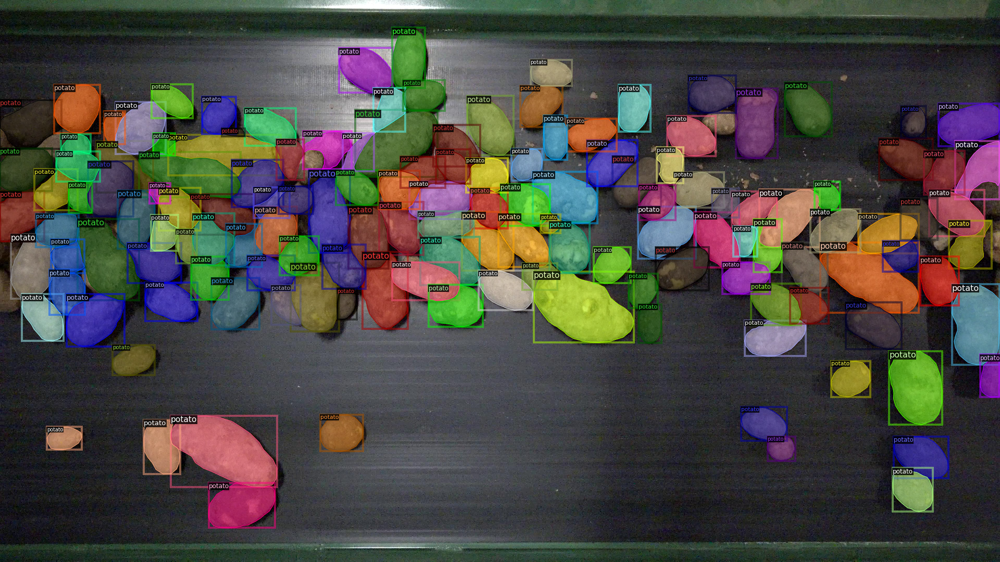

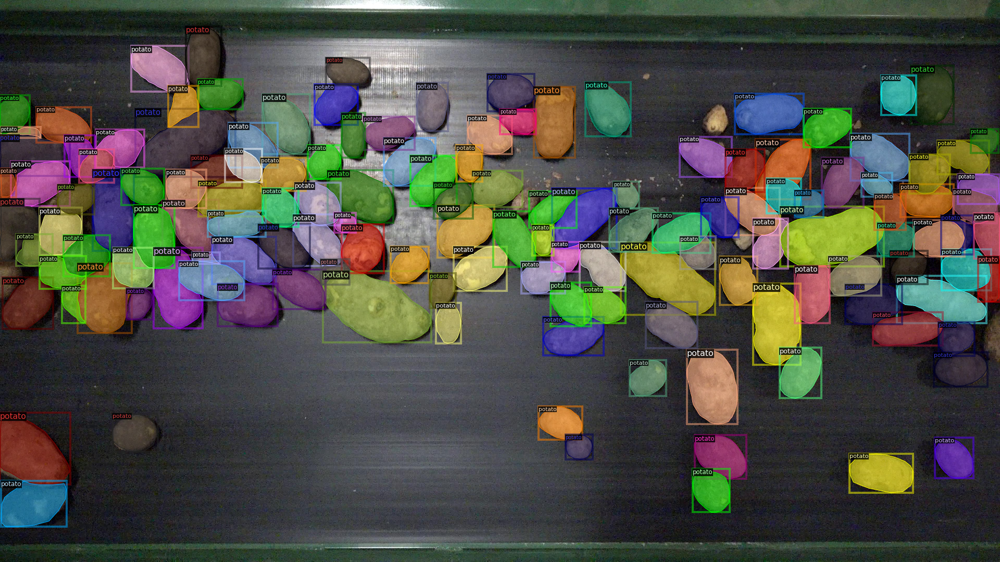

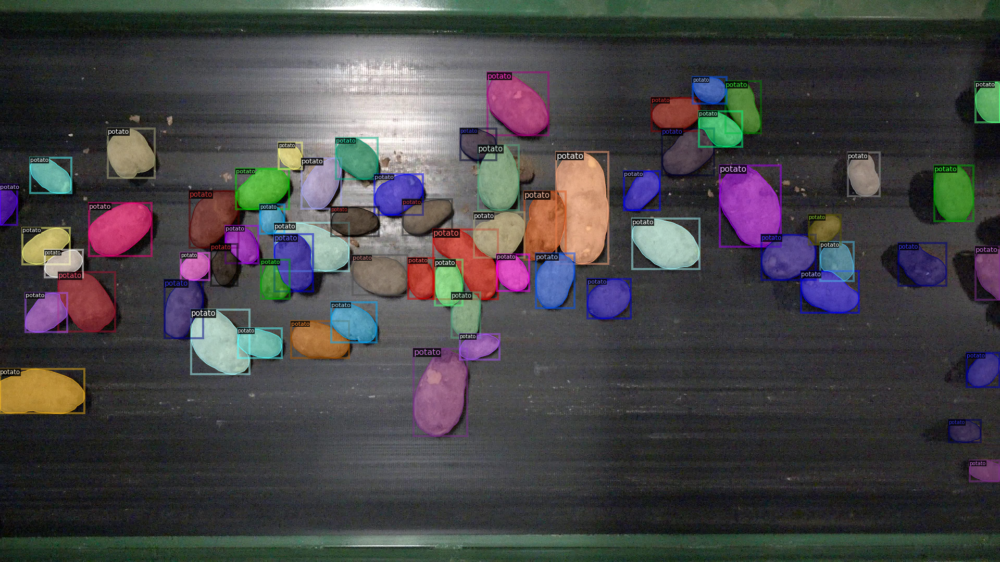

In [ ]:
#visualize testing data
my_dataset_test_metadata = MetadataCatalog.get("data_val")
test_data_dicts = DatasetCatalog.get("data_val")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(test_data_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("data_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "data_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))


WARNING [06/06 19:30:36 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/06 19:30:36 d2.data.datasets.coco]: Loaded 10 images in COCO format from /content/drive/My Drive/Dataset/valid/test.coco.json
[06/06 19:30:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[06/06 19:30:36 d2.data.common]: Serializing 10 elements to byte tensors and concatenating them all ...
[06/06 19:30:36 d2.data.common]: Serialized dataset takes 0.23 MiB
[06/06 19:30:36 d2.evaluation.evaluator]: Start inference on 10 batches
[06/06 19:31:38 d2.evaluation.evaluator]: Total inference time: 0:00:29.404588 (5.880918 s / iter per device, on 1 devices)
[06/06 19:31:38 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.356554 s / iter per device, on 1 devices)
[06/06 19:31:38 d2.evaluation.coco_evaluation]: Preparin

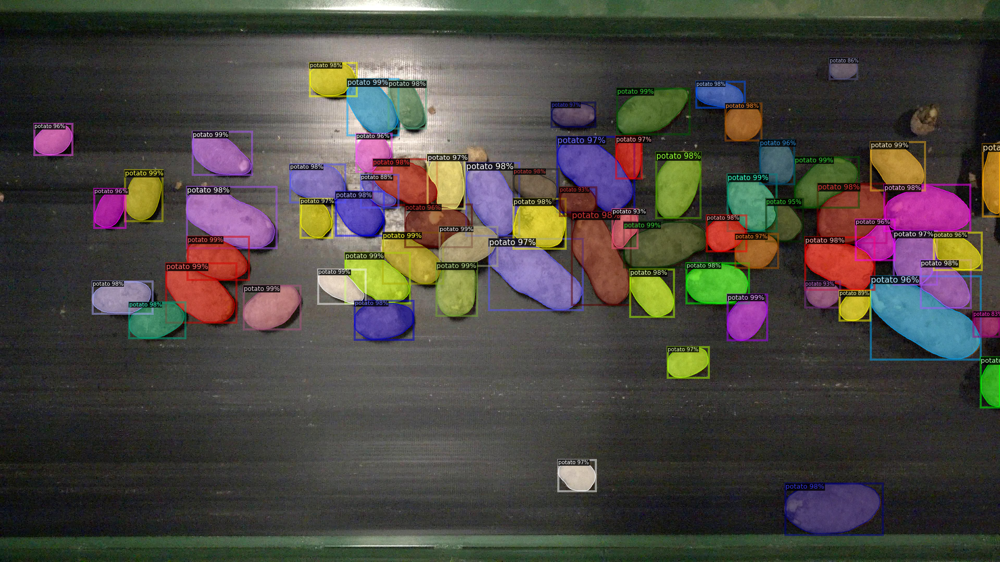

In [ ]:
from detectron2.utils.visualizer import ColorMode
for d in random.sample(test_data_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_dataset_test_metadata, 
                   scale=0.5 
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.utils.visualizer import ColorMode
  
im = cv2.imread(r"/content/testimg3.png")
outputs = predictor(im)  


In [ ]:
outputs

{'instances': Instances(num_instances=100, image_height=2160, image_width=3840, fields=[pred_boxes: Boxes(tensor([[8.2545e+02, 1.1438e+03, 1.0718e+03, 1.3799e+03],
         [1.4141e+03, 1.8098e+03, 1.5851e+03, 1.9594e+03],
         [2.9462e+03, 1.3675e+03, 3.1557e+03, 1.5603e+03],
         [1.4177e+03, 8.9667e+01, 1.6343e+03, 2.2889e+02],
         [2.9888e+03, 1.5387e+03, 3.2021e+03, 1.6676e+03],
         [2.3179e+03, 8.3204e+02, 2.5509e+03, 1.0572e+03],
         [1.9699e+02, 1.0051e+03, 3.6894e+02, 1.3345e+03],
         [3.1245e+03, 1.1758e+03, 3.4585e+03, 1.3521e+03],
         [2.4741e+03, 5.5354e+02, 2.6319e+03, 8.1117e+02],
         [1.5471e+03, 1.6794e+03, 1.6673e+03, 1.8670e+03],
         [1.7389e+03, 1.6345e+03, 1.8999e+03, 1.7624e+03],
         [1.3143e+03, 8.7454e+02, 1.4883e+03, 1.0590e+03],
         [2.1451e+03, 9.1241e+02, 2.3420e+03, 1.0743e+03],
         [6.2399e+02, 1.0595e+03, 8.9678e+02, 1.2517e+03],
         [1.9396e+03, 1.1842e+03, 2.2199e+03, 1.3690e+03],
         [

In [29]:
im

array([[[47, 69, 50],
        [49, 71, 52],
        [43, 65, 46],
        ...,
        [40, 45, 28],
        [40, 45, 28],
        [40, 45, 28]],

       [[47, 69, 50],
        [49, 71, 52],
        [43, 65, 46],
        ...,
        [48, 53, 36],
        [50, 55, 38],
        [50, 55, 38]],

       [[47, 69, 50],
        [49, 71, 52],
        [43, 65, 46],
        ...,
        [49, 57, 40],
        [50, 58, 41],
        [50, 58, 41]],

       ...,

       [[26, 29,  6],
        [26, 29,  6],
        [26, 29,  6],
        ...,
        [28, 38, 21],
        [28, 38, 21],
        [28, 38, 21]],

       [[36, 40, 12],
        [36, 40, 12],
        [36, 40, 12],
        ...,
        [28, 38, 21],
        [28, 38, 21],
        [28, 38, 21]],

       [[16, 20,  0],
        [16, 20,  0],
        [16, 20,  0],
        ...,
        [28, 38, 21],
        [28, 38, 21],
        [28, 38, 21]]], dtype=uint8)

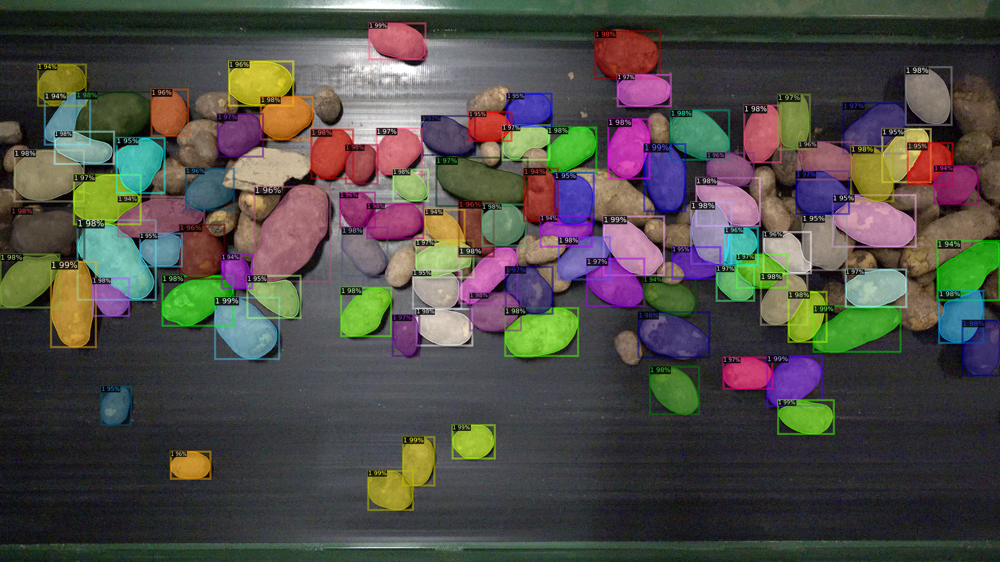

In [ ]:
v = Visualizer(im[:, :, ::-1],
   
                   scale=0.5 
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
mask= outputs['instances'].get('pred_masks')

tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]],

        [[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [

In [24]:
mask.shape

torch.Size([100, 2160, 3840])

In [37]:
mask.shape[2]

3840

In [56]:
outputs['instances'].get('pred_boxes')[0].tensor.cpu().numpy()[0]

array([ 825.4488, 1143.7996, 1071.7515, 1379.9084], dtype=float32)

In [33]:
roi = outputs['instances'].get('pred_boxes')

In [43]:
roi[0]

Boxes(tensor([[ 825.4488, 1143.7996, 1071.7515, 1379.9084]], device='cuda:0'))

In [70]:
round(roi[0].tensor.cpu().numpy()[0][3])

1380

In [88]:
roi[0].tensor.cpu()[0][0]

tensor(825.4488)

In [99]:
np.any(mask.cpu()[0].numpy() * 255 == 255)

True

In [ ]:
m2 = 255 * m1
  image_pil = Image.fromarray(np.uint8(m2.cpu()))
  image_pil.save('n.jpg')
  img1 = ImageDraw.Draw(image_pil)

  img1.rectangle(shape, outline = "green")
  image_pil.show()
  plt.imshow(image_pil)

In [ ]:
[(round(roi[i].tensor.cpu().numpy()[0][1]), round(roi[i].tensor.cpu().numpy()[0][0])), (round(roi[i].tensor.cpu().numpy()[0][3]), round(roi[i].tensor.cpu().numpy()[0][2]))]

In [83]:
mask.shape

torch.Size([100, 2160, 3840])

In [100]:
from PIL import Image, ImageDraw
import cv2
from matplotlib import pyplot as plt
image_pil = Image.fromarray(np.uint8(im))
image_pil.save("img.jpg")
cvImage = cv2.imread("img.jpg")
for i in range(mask.shape[0]):
  m1 = mask[:, :, i]
  roi = outputs['instances'].get('pred_boxes')
  shape = [(round(roi[i].tensor.cpu().numpy()[0][1]), round(roi[i].tensor.cpu().numpy()[0][0])), (round(roi[i].tensor.cpu().numpy()[0][3]), round(roi[i].tensor.cpu().numpy()[0][2]))]
  m2 = 255 * m1.cpu().numpy()
  image_pil = Image.fromarray(np.uint8(m2))
  image_pil.save('n.jpg')
  img1 = ImageDraw.Draw(image_pil)

  #img1.rectangle(shape, outline = "green")
  #image_pil.show()
  #plt.imshow(image_pil)

In [31]:
mask[:, :, 1]

tensor([[False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        ...,
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False]], device='cuda:0')

In [ ]:
images= glob.glob('/content/drive/My Drive/normal/*')
for idx, image in enumerate(images):
    img= cv2.imread(image)
    outputs= predictor(img)
    mask= outputs['instances'].get('pred_masks')
    mask= mask.to('cpu')
    num, h, w= mask.shape
    bin_mask= np.zeros((h, w))
    
    for m in mask:
        bin_mask+= m
    filename= './bin_masks/'+str(idx+1)+'.png'
    cv2.imwrite(filename, bin_mask)

In [68]:
mask= outputs['instances'].get('pred_masks')
mask= mask.to('cpu')
num, h, w= mask.shape
bin_mask= np.zeros((h, w))
arr = []
for m in mask:
  arr.append(m)  
bin_mask = np.concatenate(arr)
#filename= './bin_masks/'+str(idx+1)+'.png'
cv2.imwrite("image.jpg", bin_mask)

TypeError: ignored

In [65]:
bin_mask

tensor([[False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        ...,
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False],
        [False, False, False,  ..., False, False, False]])

In [101]:
im.shape[0]

2160

In [136]:
mask_array = outputs['instances'].pred_masks.to("cpu").numpy()
num_instances = mask_array.shape[0]
scores = outputs['instances'].scores.to("cpu").numpy()
labels = outputs['instances'].pred_classes .to("cpu").numpy()
#bbox   = outputs['instances'].pred_boxes.to("cpu").tensor.numpy()

mask_array = np.moveaxis(mask_array, 0, -1)

mask_array_instance = []
#img = np.zeros_like(im) #black
h = im.shape[0]
w = im.shape[1]
img_mask = np.zeros([h, w, 3], np.uint8)
color = (200, 100, 255)
roi = outputs['instances'].get('pred_boxes')
for i in range(num_instances):
    img = np.zeros_like(im)
    mask_array_instance.append(mask_array[:, :, i:(i+1)])
    img = np.where(mask_array_instance[i] == True, 255, img)
    array_img = np.asarray(img)
    shape = [(roi[i].tensor.cpu().numpy()[0][0], roi[i].tensor.cpu().numpy()[0][1]), (roi[i].tensor.cpu().numpy()[0][2], roi[i].tensor.cpu().numpy()[0][3])]
    image = Image.fromarray(array_img)
    img1 = ImageDraw.Draw(image)
    img1.rectangle(shape, outline="green")
    image.save("{i}.png".format(i=i))
    

In [116]:
image = Image.fromarray(array_img)
img1 = ImageDraw.Draw(image)
img1.rectangle()

In [133]:
mask_array = outputs['instances'].pred_masks.to("cpu").numpy()
num_instances = mask_array.shape[0]
scores = outputs['instances'].scores.to("cpu").numpy()
labels = outputs['instances'].pred_classes .to("cpu").numpy()
bbox   = outputs['instances'].pred_boxes.to("cpu").tensor.numpy()

mask_array = np.moveaxis(mask_array, 0, -1)

mask_array_instance = []
#img = np.zeros_like(im) #black
h = im.shape[0]
w = im.shape[1]
img_mask = np.zeros([h, w, 3], np.uint8)
color = (200, 100, 255)
for i in range(num_instances):
    img = np.zeros_like(im)
    roi = outputs['instances'].get('pred_boxes')
    #shape = [(round(roi[i].tensor.cpu().numpy()[0][0]), round(roi[i].tensor.cpu().numpy()[0][1])), (round(roi[i].tensor.cpu().numpy()[0][2]), round(roi[i].tensor.cpu().numpy()[0][3]))]
    
    shape = [(roi[i].tensor.cpu().numpy()[0][0], roi[i].tensor.cpu().numpy()[0][1]), (roi[i].tensor.cpu().numpy()[0][2], roi[i].tensor.cpu().numpy()[0][3])]
    mask_array_instance.append(mask_array[:, :, i:(i+1)])
    img = np.where(mask_array_instance[i] == True, 255, img)
    array_img = np.asarray(img)
    image = Image.fromarray(array_img)
    img1 = ImageDraw.Draw(image)
    img1.rectangle(shape, outline="green")
    #cv2.imwrite("{i}.jpg".format(i=i), img1)
    

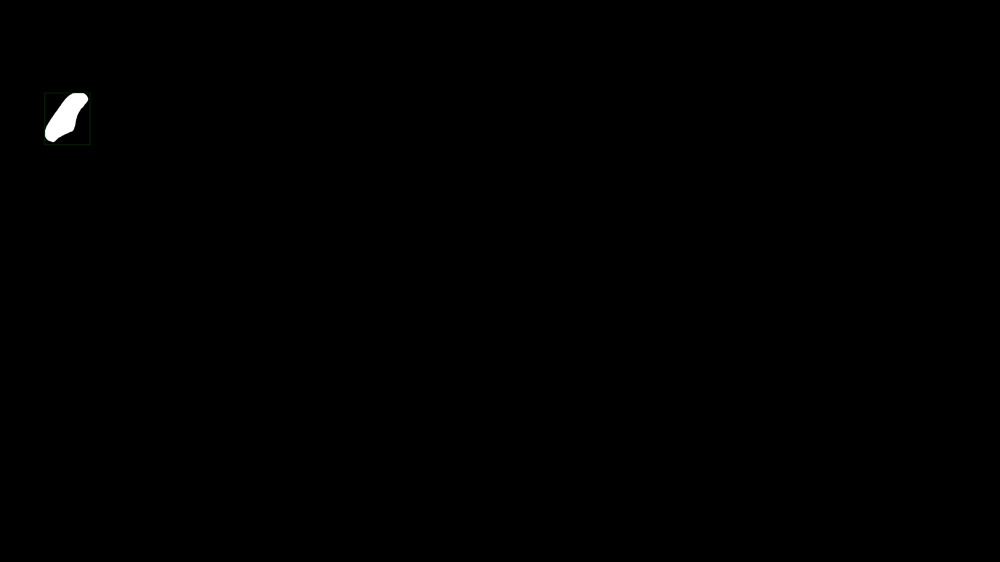

In [134]:
image

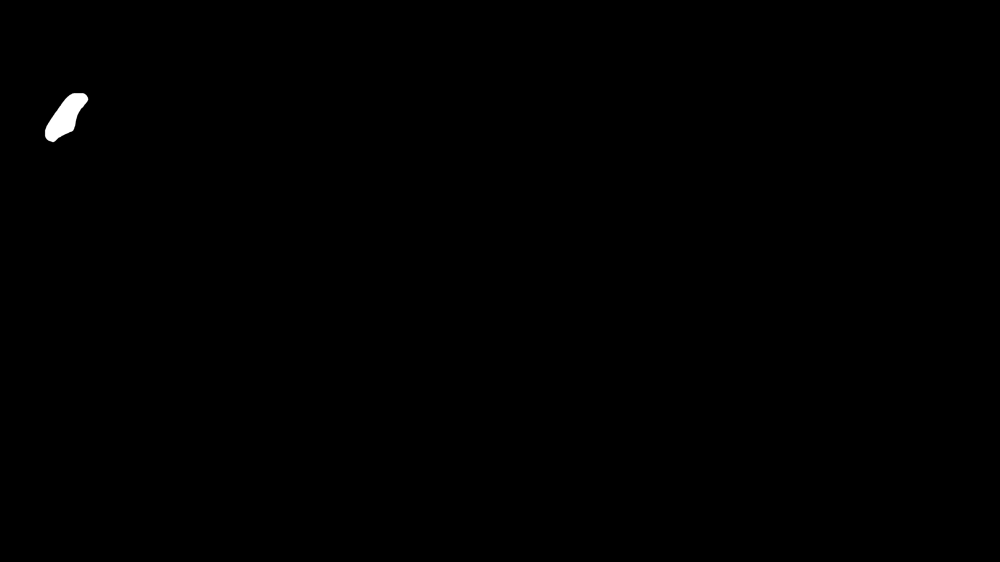

In [115]:
image

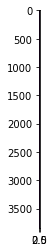

In [109]:
plt.imshow(img_mask[0])

In [ ]:
img_mask[np.where((array_img==[255,255,255]).all(axis=2))]=color
img_mask = np.asarray(img_mask)
output = cv2.addWeighted(im, 0.7, img_mask, 0.3, 0)